# UFRJ Analytica - Processo Seletivo 2022

Por Marcos Eduardo

## Introdução

O Citi Bike é um sistema público de compartilhamento de bicicletas de propriedade privada que atende os bairros de Nova York do Bronx, Brooklyn, Manhattan e Queens, bem como Jersey City e etc. Foi inaugurado oficialmente em maio de 2013 com 332 estações e 6.000 bicicletas. Nessa análise nós iremos lidar com os dados do ano de 2019.

## Levantamento de perguntas


Antes de analisar os dados, vamos começar fazendo algumas perguntas que talvez queiramos entender sobre o funcionamento do share bike. Podemos nos perguntar que tipos de informações gostaríamos de conhecer para tomar decisões mais mais inteligentes? Além disso, se formos usuários do serviço, quais fatores podem influenciar em nosso usar do serviço?

Possíveis perguntas:

* Como é distribuido o tempo de uso das biciletas.
* Quais os meses com viagems mais duradouras.
* Como é a distrubioção do uso das bicicletas por idade e gênero.
* Quais os horário de maior demanda.
* Qual dia da semana de maior deamanda.
* Quem são os tipos de usuários com duração de viagem mais longas.
* Quais são as 10 Estações mais ultilizadas.
* Estações com mais usuários assinante.
* Quais as rotas mais realizadas.
* Usuários que fazem corridas paralelas.

## Descrição das Features

O nosso conjunto de dados é descrito da seguinte forma:

|Atributo                                           |   Descrição   |
|---------------------------------------------------|:-------------:|
| tripduration                                      |   Duração da viagem em segundos | 
| starttime                                         |   Início da viagem | 
| stoptime                                          |   Fim da Viagem   | 
| start station id                                  |   ID da estação origem   | 
| start station name                                |   Nome da estação onde a viagem começou|
| start station latitude / start station longitude  |   Localização onde a viagem começou|
| end station id                                    |   ID da estação destino   | 
| end station name                                  |   Nome da estação onde a viagem terminou|
| end station latitude /end station longitude       |   Localização onde a viagem terminou   |
| Bike ID                                           |   ID da bicicleta  |
| usertype                                          |   Customer = passe de 24 horas ou 3 dias; Subscriber = Membro Anual |
| birth year                                        |   Ano de nascimento|
| gender                                            |   0 = desconhecido; 1 = masculino; 2 = feminino |


Os dados foram retirados do kaggle: [New York City Bike Share Dataset](https://www.kaggle.com/datasets/akkithetechie/new-york-city-bike-share-dataset).

In [190]:
import numpy as np 
import pandas as pd 
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt
import sys
from math import sqrt
import plotly.graph_objects as go
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestRegressor

## Análise Prelimiar

### Limpeza e Tratamento de Dados

In [76]:
#importar dados
df = pd.read_csv('data_bike2019.csv')
df.describe()

,tripduration,start station id,start station latitude,start station longitude,end station id,end station latitude,end station longitude,bikeid,birth year,gender
count,4.049470e+05,404947.000000,404947.000000,404947.000000,404947.000000,404947.000000,404947.000000,404947.000000,404947.000000,404947.000000
mean,7.258427e+02,3294.022391,40.722722,-74.046333,3292.219142,40.722328,-74.045792,28465.511998,1981.417524,1.162335
std,9.785237e+03,171.021930,0.007037,0.010871,180.886426,0.006885,0.010829,1654.373618,10.257440,0.516120
min,6.100000e+01,3183.000000,40.709651,-74.083639,116.000000,40.695065,-74.083639,14792.000000,1887.000000,0.000000
25%,2.330000e+02,3195.000000,40.718355,-74.050444,3192.000000,40.718355,-74.050389,26286.000000,1975.000000,1.000000
50%,3.450000e+02,3210.000000,40.721525,-74.043845,3207.000000,40.721124,-74.043117,29284.000000,1984.000000,1.000000
75%,5.800000e+02,3276.000000,40.727224,-74.038051,3276.000000,40.727224,-74.038051,29536.000000,1989.000000,1.000000
max,2.566420e+06,3792.000000,40.748716,-74.032108,3792.000000,40.814326,-73.932077,41913.000000,2003.000000,2.000000


Em uma análise parcial, podemos notar que o `birth year` possui um valor minimo fora do normal.

In [77]:
# Verificando tamanho
linhas, colunas = df.shape
print(f"Total de linhas: {linhas}\nTotal de colunas: {colunas}")

Total de linhas: 404947
Total de colunas: 15


Uma pequena amostro dos dados que estamos trabalhando.

In [78]:
df.sample(3)

,tripduration,starttime,stoptime,start station id,start station name,start station latitude,start station longitude,end station id,end station name,end station latitude,end station longitude,bikeid,usertype,birth year,gender
115186,516,2019-05-18 16:19:30.8730,2019-05-18 16:28:06.8810,3183,Exchange Place,40.716247,-74.033459,3267,Morris Canal,40.712419,-74.038526,29524,Customer,1969,0
388413,243,2019-12-05 18:43:41.5840,2019-12-05 18:47:44.8410,3273,Manila & 1st,40.721651,-74.042884,3278,Monmouth and 6th,40.725685,-74.048790,26305,Subscriber,1986,2
19449,151,2019-01-10 07:41:09.2350,2019-01-10 07:43:40.7090,3681,Grand St,40.715178,-74.037683,3183,Exchange Place,40.716247,-74.033459,26159,Subscriber,1974,1


In [79]:
df.info() #Verificando tipo de dados

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 404947 entries, 0 to 404946
Data columns (total 15 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   tripduration             404947 non-null  int64  
 1   starttime                404947 non-null  object 
 2   stoptime                 404947 non-null  object 
 3   start station id         404947 non-null  int64  
 4   start station name       404947 non-null  object 
 5   start station latitude   404947 non-null  float64
 6   start station longitude  404947 non-null  float64
 7   end station id           404947 non-null  int64  
 8   end station name         404947 non-null  object 
 9   end station latitude     404947 non-null  float64
 10  end station longitude    404947 non-null  float64
 11  bikeid                   404947 non-null  int64  
 12  usertype                 404947 non-null  object 
 13  birth year               404947 non-null  int64  
 14  gend

In [80]:
print(f"Total de linhas duplicadas: {df.duplicated().sum()}") # Verificando existencia de linhas duplicadas
df = df.drop_duplicates() # Remoção das duplicatas

Total de linhas duplicadas: 0


In [81]:
df.isnull().sum() # Verificando campos nulos

tripduration               0
starttime                  0
stoptime                   0
start station id           0
start station name         0
start station latitude     0
start station longitude    0
end station id             0
end station name           0
end station latitude       0
end station longitude      0
bikeid                     0
usertype                   0
birth year                 0
gender                     0
dtype: int64

In [82]:
df['bikeid'].count() # Total de usuarios que alugaram bicicletas em 2020

404947

#### Alterando os tipos de dados

In [83]:
# string para datatime
df['birth year'] = pd.to_numeric(df['birth year'], downcast='integer')
df['starttime'] = pd.to_datetime(df['starttime'])
df['stoptime'] = pd.to_datetime(df['stoptime'])
# integer para category
df['gender'] = df['gender'].astype('category')

### Calculando a idade

Como o nosso conjuneto de dados é do ano de 2019, usaremos esse ano como base das idades.

In [84]:
df['age'] = 2019-df['birth year']

## Análise Exploratória

Temos `40.4947` usuários que alugaram bicicletas em 2019. A viagem mais longa foi de `2.566.420` segundos.


### Extraindo dia, dias da semana e hora do dataset

In [85]:
df['start_month'] = df['starttime'].dt.month_name()        #Extraindo mês
df['start_hours'] = df['starttime'].dt.hour                # Extraindo hora
df['start_weekday'] = df['starttime'].dt.weekday           # Extraindo dia da semana 
df['start_weekday_name'] = df['starttime'].dt.day_name()   # Extraindo nome do dia da semana
df['tripduration_in_min'] = df['tripduration'].apply(lambda x: round(x/60))     # Criando duração em minutos

### Duração da Viagem

In [86]:
desc = df['tripduration'].describe()
desc

count    4.049470e+05
mean     7.258427e+02
std      9.785237e+03
min      6.100000e+01
25%      2.330000e+02
50%      3.450000e+02
75%      5.800000e+02
max      2.566420e+06
Name: tripduration, dtype: float64

A duração máxima de uma viagem com `2.566.420` segundos, não é atipica. Em um conversão rápida, temos `42.773` minutos e `712` horas.

In [87]:
# Calculando limite superior do boxplot
Q1 = desc[4]
Q3 = desc[6]
IQR = Q3-Q1
upper_bound = Q3 + 1.5*IQR
print(f"Limite Superior: {upper_bound}")

Limite Superior: 1100.5


##### Análise estatística

- Cerca de 75% do tempo, os ciclistas gastam em torno de `580` segundos ou `9,6` minutos na viagem
- Os ciclistas andam de bicicleta por pelo menos `61` segundos.
- Em média, `725,8` segundos, o que significa `12` minutos.

Vamos considerar nessa análise, que a `duração máxima` do uso das bicicletas não vão ultrapassar `24` horas.

In [88]:
# Verificando quantidade de viagens acima de 24horas
df[df['tripduration'] >=24*60*60].shape

(150, 21)

In [89]:
# Duração máxima de 1 dia
df = df[df['tripduration'] <=24*60*60]

### Verificando Estações

In [90]:
endStation = df[['end station name', 'end station longitude', 'end station latitude']].drop_duplicates()
startStation= df[['start station name', 'start station longitude', 'start station latitude']].drop_duplicates()

In [91]:
fig = px.scatter_mapbox(endStation, lat="end station latitude", lon="end station longitude", hover_name = "end station name",
                 width=900, height=600, zoom=12, mapbox_style="carto-positron")

fig.add_trace(go.Scattermapbox(
        lat=startStation['start station latitude'],
        lon=startStation['start station longitude'],
        mode='markers',
        name="start station name",
        marker=go.scattermapbox.Marker(
            size=5,
            color='rgb(0, 255,0)',
            opacity=0.7
        ),
        text=startStation['start station name'],
        hoverinfo='text'
    ))
fig.update_layout(
                    margin={"r":0,"t":0,"l":0,"b":0},
                    showlegend=False)
fig.show()

Nosso conjunto de dados foi fornecido para a `Jersey City`, logo as estações em `azul` não deveriam fazer parte do nosso conjuto. A estação de New York mais próxima de Jersey é a `West Thames St`, vamos usar sua longitude para remover individuos com a longetude menor.

In [92]:
df = df[df['end station longitude'] < -74.018]

Agora vamos verificar se existe uma mesma estação e local diferente

In [93]:
duplicate = df.groupby(['start station name','start station latitude', 'start station longitude']).size().reset_index(name='count')
duplicate['start station name'].duplicated().sum()

1

Vamos verificar qual estação é essa.

In [94]:
duplicate = df.groupby(['start station name','start station latitude', 'start station longitude', 'start station id']).size().reset_index(name='count')
duplicate[duplicate['start station name'].duplicated()]

,start station name,start station latitude,start station longitude,start station id,count
48,Sip Ave,40.730897,-74.063913,3195,16878


In [95]:
duplicate[duplicate['start station name'] == 'Sip Ave']

,start station name,start station latitude,start station longitude,start station id,count
47,Sip Ave,40.730743,-74.063784,3195,2192
48,Sip Ave,40.730897,-74.063913,3195,16878


In [96]:
# Removendo colunas desnecessárias
df.drop(['end station id', 'start station id'],axis=1,inplace=True)

## Distribuição duração viagem (tempo de uso)

Como vimos nosso limite superior é de `1100.5` segundos, ou seja, `18` minutos. Vamos vizualiar a distribuição do uso limitado em até `60` minutos.

In [97]:
# Tempo de uso em minutos com limitado em 60 min
fig = px.histogram(df, x="tripduration_in_min")
fig.update_layout(xaxis_range=[1,60])
fig.show()

###  Verificando idades dos clientes

In [98]:
df['age'].describe()

count    404634.000000
mean         37.580406
std          10.256020
min          16.000000
25%          30.000000
50%          35.000000
75%          44.000000
max         132.000000
Name: age, dtype: float64

Uma média de `37` anos, sendo o mais novo com 16 anos e o mais velho com 132 anos.

In [99]:
# Verificando quantidades de pessoas com mais de 100 anos
df[df['age'] > 100].shape[0]

196

Nosso limite superior para idade é de 65 anos, porem vamos permitir alguns outlirs. Limitando a idade em 70 anos.

In [100]:
#Removendo idade menores que 70
df = df[df['age'] <=70]

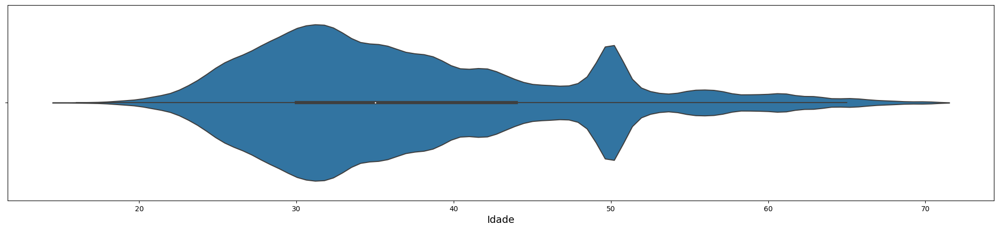

In [101]:
plt.figure(figsize = (25,5))
sns.violinplot(x='age', data=df)
plt.xlabel('Idade', fontsize=14)
plt.show()

### Média de viagens por idade

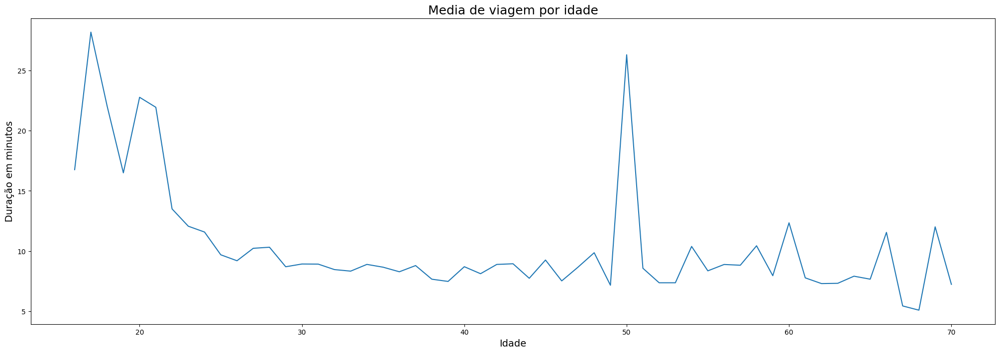

In [102]:
# Media de viagem por idade
plt.figure(figsize = (25,8))

plt.title('Media de viagem por idade', fontsize=18)
plt.xlabel('Idade', fontsize=14)
plt.ylabel('Duração em minutos', fontsize=14)

average_trip = df.groupby('age')['tripduration_in_min'].mean().reset_index().rename(columns={'age': 'idade', 'tripduration_in_min':'media'})
sns.lineplot(data =average_trip, x='idade', y='media')
plt.show()


### Dividindo as idades em grupos

In [103]:
df['ageGroup']= pd.cut(
   df['age'],
   bins=[0, 20, 30, 40, 50, 60, sys.maxsize],
   labels=['<20', '20-29', '30-39', '40-49', '50-59', '60+']
)

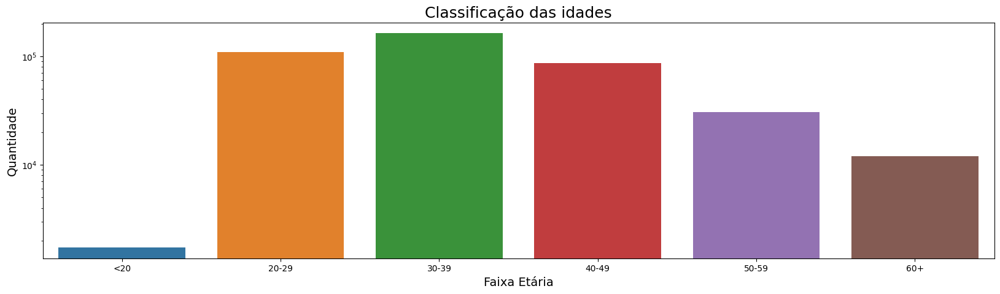

In [104]:
plt.figure(figsize = (20,5))
ax = sns.countplot(x=df["ageGroup"])
ax.get_figure().get_axes()[0].set_yscale('log')
plt.title('Classificação das idades', fontsize=18)
plt.xlabel('Faixa Etária', fontsize=14)
plt.ylabel('Quantidade', fontsize=14)
plt.show()

### Como é a proporção da idade por dia de semana?

In [105]:
weekOrder = ['Sunday', 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday']
fig = px.histogram(df, x="start_weekday_name",
             color='ageGroup', barmode='group',
             height=400, title='Idade x Dia da semana', log_y=True)
fig.update_xaxes(categoryorder='array', categoryarray= weekOrder)

fig.show()

Podemos notar que a concentração para todas as idades está nos finais de semana, cosequentemente podendo gerar um `pico` uma alta procura nesses dias.

## Média de duração do uso por mês

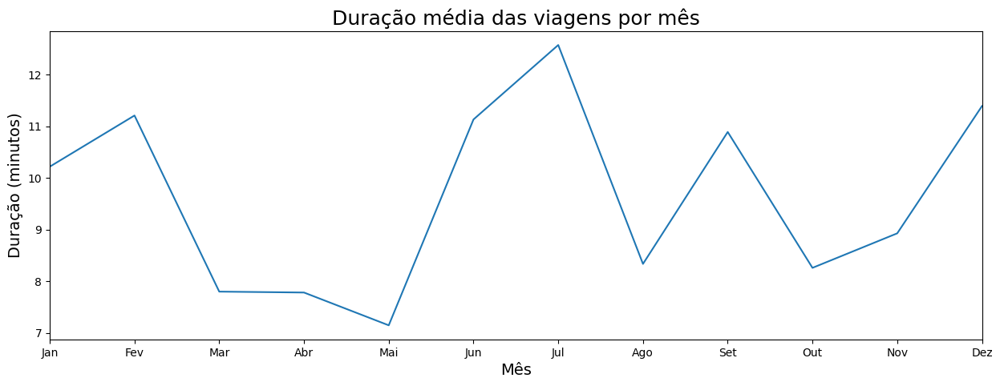

In [106]:
plt.figure(figsize = (15,5))

ax = df.groupby('start_month')['tripduration_in_min'].mean().plot()
ax.set_xlim(0, 11)
plt.xticks(range(0,12), ['Jan', 'Fev', 'Mar', 'Abr', 'Mai', 'Jun', 'Jul', 'Ago', 'Set', 'Out', 'Nov', 'Dez'])

plt.title('Duração média das viagens por mês', fontsize=18)
plt.xlabel('Mês', fontsize=14)
plt.ylabel('Duração (minutos)', fontsize=14)
plt.show()

O mês de `Julho` é o mês com as viagens médias mais longas, uma possivel justificativa para isso, pode ser por conta do feriado 4 julho que comemora a independência dos EUA.

In [107]:
july = df[df['start_month'] == 'July'].copy()
july['start_day']= july['starttime'].dt.day

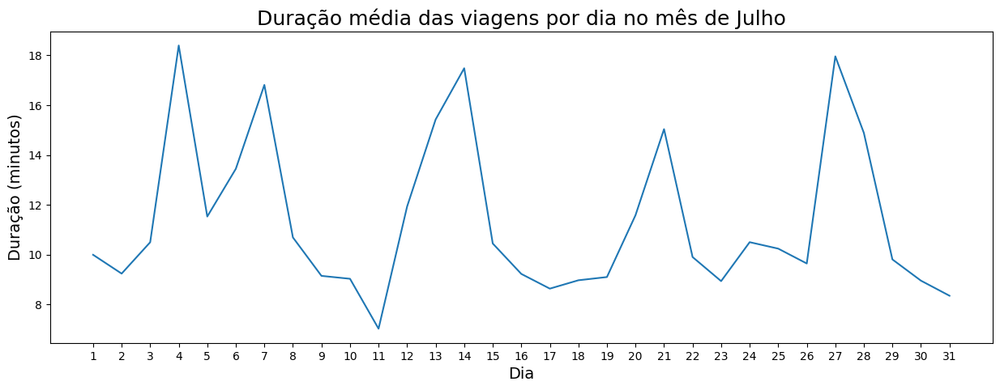

In [108]:
plt.figure(figsize = (15,5))
plt.xticks(range(1,32))

july.groupby('start_day')['tripduration_in_min'].mean().plot()

plt.title('Duração média das viagens por dia no mês de Julho', fontsize=18)
plt.xlabel('Dia', fontsize=14)
plt.ylabel('Duração (minutos)', fontsize=14)
plt.show()

Como deduzido, o dia 4 de julho foi o dia com maior duração média nas viagens.

## Tipos de clientes

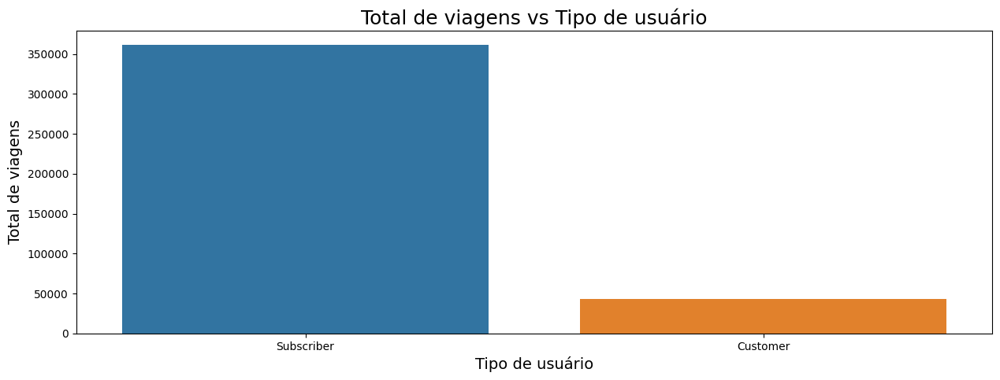

In [109]:
plt.figure(figsize = (15,5))
ax = sns.countplot(data= df, x = 'usertype', order = df['usertype'].value_counts().index)
plt.xlabel('Tipo de usuário', fontsize=14)
plt.ylabel('Total de viagens', fontsize=14)
plt.title('Total de viagens vs Tipo de usuário', fontsize=18)
plt.show()

## Proporção dos Gênero

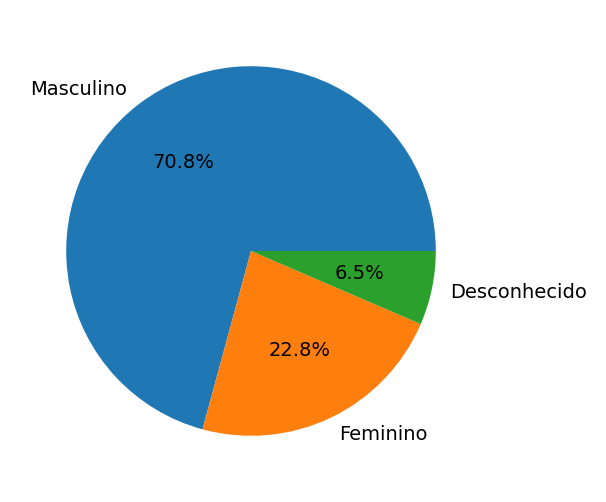

In [110]:
plt.figure(figsize=(3,3), dpi=200)
mylabels = ["Masculino", "Feminino", "Desconhecido"]
plt.pie(df['gender'].value_counts(), labels = mylabels, autopct='%1.1f%%', textprops={'fontsize': 7})
plt.show() 

### Relação Idade e Gênero

In [111]:
# Criando uma nova tabela com idade e gêneros
gender_age = pd.crosstab(index=df['gender'], columns=df['ageGroup'], rownames=['gender'], colnames=['Faixa Etaria'])
gender_age = pd.DataFrame(gender_age) 
gender_age = gender_age.rename(index={1: 'Masculino', 2: 'Feminino', 0: 'Desconhecido'}) #Adicionando nomes as linhas
gender_age = (gender_age / len(df)).round(2)

In [112]:
# Cada bloco mostra a porcentagem das viagens que foram feitas por essa idade + gênero
# Somando todas temos 1.0, equivalente a 100%
gender_age

Faixa Etaria,<20,20-29,30-39,40-49,50-59,60+
gender,,,,,,
Desconhecido,0.0,0.00,0.0,0.06,0.00,0.00
Masculino,0.0,0.19,0.3,0.13,0.06,0.02
Feminino,0.0,0.08,0.1,0.03,0.01,0.01


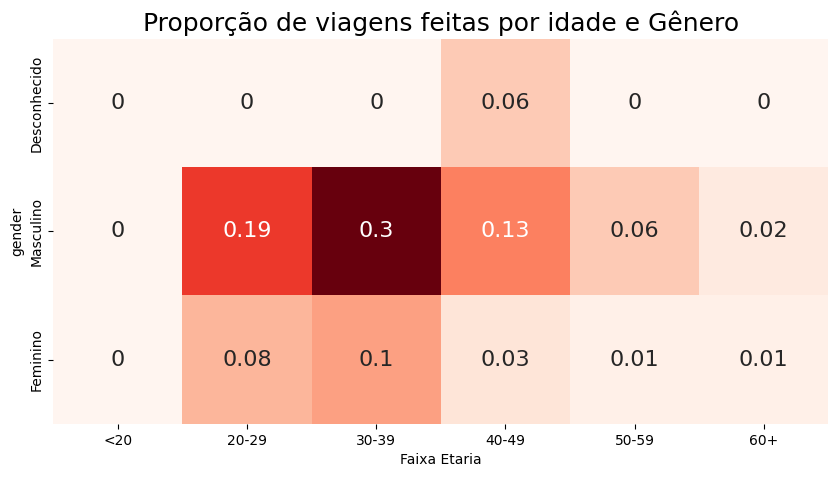

In [113]:
plt.figure(figsize = (10,5))
ax = sns.heatmap(gender_age, annot=True, linewidths=0, cbar=False, cmap="Reds", annot_kws={"size": 16})
ax.set_title('Proporção de viagens feitas por idade e Gênero', fontsize=18)
plt.show()


O nosso dataset possui `32%` de homens com faixa etária de `30 a 39 anos`. Enquanto temos `9%` para mulheres na mesma faixa etária.

#### Viagens durante a semana por gênero

In [114]:
fig = px.histogram(df, x="start_weekday_name",
             color='gender', barmode='group',
             height=400, labels={0: "Desconhcido", 1: "Masculino", 2: "Feminino"})
fig.update_xaxes(categoryorder='array', categoryarray= weekOrder)
fig.update_layout(legend_title_text='Gênero')
fig.show()

Os homems estão predominantemente todos os dia da semana, com um destaque na quarta-feira e quinta-feira junto das mulheres. Já o desconhecido aproveita mais os finais de semana.

## Qual o horário de maior demanda?

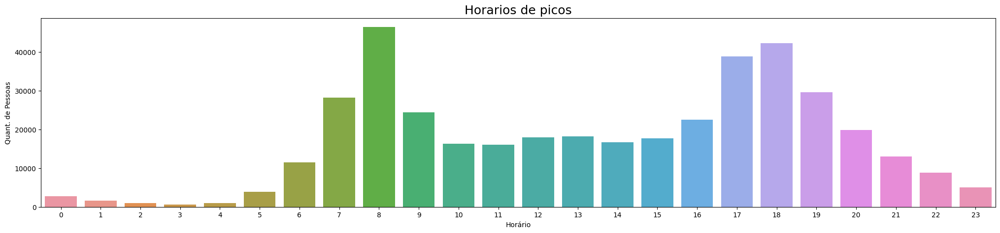

In [115]:
plt.figure(figsize = (25,5))
ax = sns.countplot(x=df["start_hours"])
ax.set(xlabel='Horário', ylabel='Quant. de Pessoas')
plt.title('Horarios de picos', fontsize=18)
plt.show()

Temos 2 pontos máximo em nosso gráfico, sendo o global as `8h`, ou seja, é o horário mais procurado para alugar uma bicicleta, e nosso máximo local as `18h`. Podemos partir da `hipótese` que o razão disso seja a ida e vinda do trabalho.

### Tipos diferentes de usuário influencia no horário?

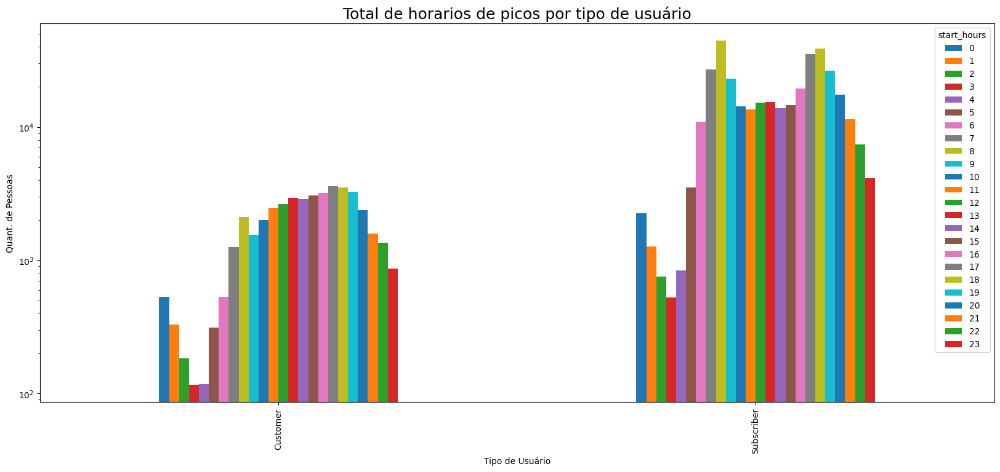

In [116]:
# Horario de picos por tipo de usuário
day=range(0,24)
count_usertype = df.groupby(['usertype','start_hours']).size().unstack()
ax = count_usertype.plot(kind = 'bar',figsize=(20,8))
ax.set(xlabel='Tipo de Usuário', ylabel='Quant. de Pessoas')
ax.get_figure().get_axes()[0].set_yscale('log')
plt.title('Total de horarios de picos por tipo de usuário', fontsize=18)
plt.show()

Temos diferença no pico para cada tipo de usuário, podemos ver que o pico das `8h` e `18h` esta mais relacionado aos clientes assinantes, enquanto os clientes "avulsos" possuem um certo padrão linear para buscar no peréodo da tarde. Fortalecendo nossa hipótese de que os assinantes usam mais para a ida e volta do trabalho. Vamos veriricar claramente isso dividindo em dia de semana e final de semana.

### Há diferença entre dia de semana e finais de semana?

In [117]:
# Separando dia util de final de semana
weekType = np.where(df['start_weekday'] < 5, 'Weekday', 'Weekend')

In [118]:
# Calculando a quantidades de horas para o dia da semana (Seg-Sex)
weekday = df[weekType == 'Weekday']
weekday = weekday['start_hours'].value_counts().sort_index()

# Calcuando para o final de semana
weekend = df[weekType != 'Weekday']
weekend = weekend['start_hours'].value_counts().sort_index()

# Calculo total
week_all = df['start_hours'].value_counts().sort_index()

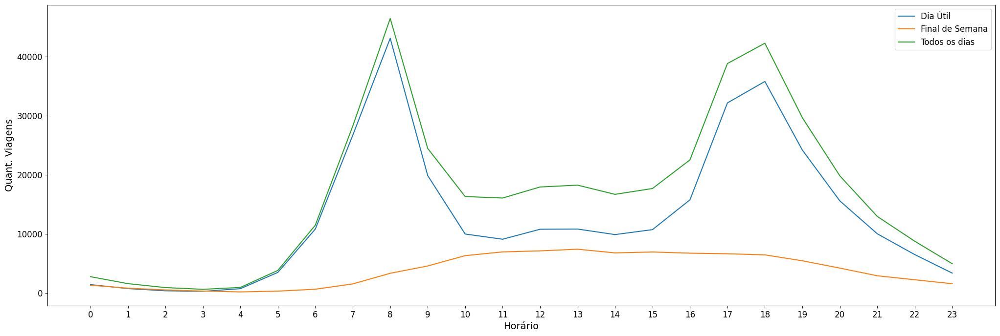

In [119]:
plt.figure(figsize = (25,8))
plt.plot(weekday)
plt.plot(weekend)
plt.plot(week_all)
plt.legend(['Dia Útil', 'Final de Semana', 'Todos os dias'], fontsize=12)
plt.xticks(range(0,24),weekday.index, fontsize=10)
plt.tick_params(axis='both', which='major', labelsize=12)

#labels
plt.xlabel('Horário', fontsize=14)
plt.ylabel('Quant. Viagens', fontsize=14)
plt.show()

Os picos das 8h e 18h se mantiveram durante os dia de semana. Enquanto finais de semana a procura é mais pelo turno da tarde, um horário mais voltado para o lazer. Reforçando o gráfico anterior, onde o gráfico do dia de semana é parecido com os ciclistas assinantens. Enquanto os não inscritos procuram alugam mais para o lazer.

## Qual dia da semana de maior procura?

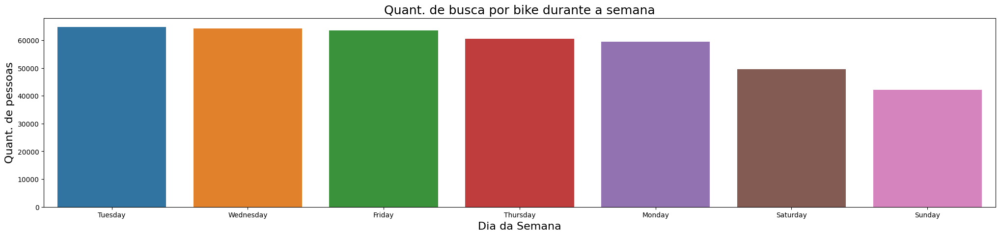

In [120]:
plt.figure(figsize = (25,5))
ax = sns.countplot(data= df, x = 'start_weekday_name', order = df['start_weekday_name'].value_counts().index)
plt.xlabel('Dia da Semana', fontsize=16)
plt.ylabel('Quant. de pessoas', fontsize=16)
plt.title('Quant. de busca por bike durante a semana', fontsize=18)
plt.show()

### O tempo de viagem tem alguma relação com a idade e o dia da semana?

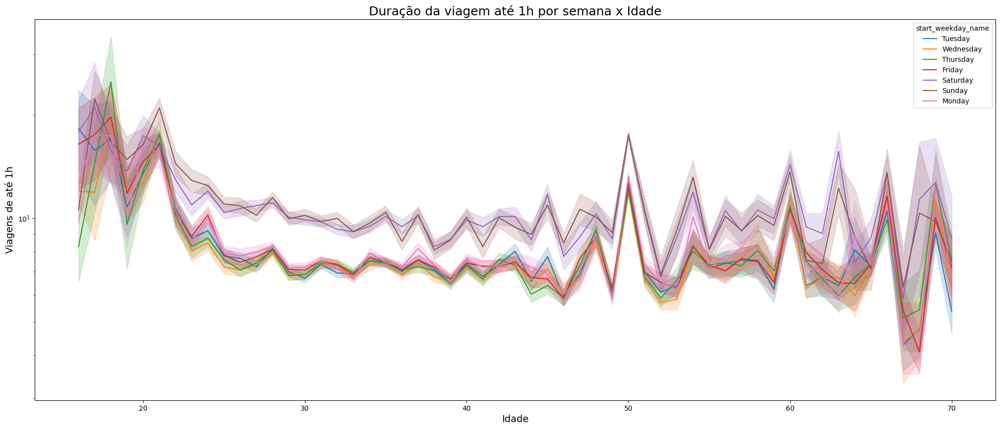

In [121]:
# Verificando duração da viagem por dia da semana em relação a idade
plt.figure(figsize = (25,10))
ax = sns.lineplot(y='tripduration_in_min', x='age', data=df[df['tripduration_in_min'] < 61], hue='start_weekday_name')
ax.get_figure().get_axes()[0].set_yscale('log')
plt.title('Duração da viagem até 1h por semana x Idade', fontsize=18)
plt.xlabel('Idade', fontsize=14)
plt.ylabel('Viagens de até 1h', fontsize=14)
plt.show()

Independente da idade, as clientes costumam ter viagens mais longas nos finais de semana, vamos confirmar isso no próximo grafico.

### Dia da semana com viagens mais longas

In [122]:
dfWeek = pd.DataFrame()
dfWeek['Week Name'] = df['start_weekday_name']
dfWeek['tripduration'] = df['tripduration']
dfWeek = dfWeek.groupby(['Week Name']).sum().reset_index()

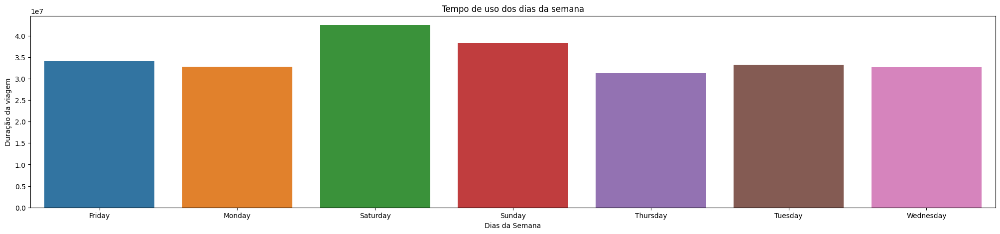

In [123]:
plt.figure(figsize = (25,5))
ax = sns.barplot(data =dfWeek ,x='Week Name',
       y='tripduration')
ax.set(xlabel='Dias da Semana', ylabel='Duração da viagem', title='Tempo de uso dos dias da semana')
plt.show()

## Estações mais procuradas

In [124]:
# Número de estações
print('Quantidade de estações: ',df['start station name'].nunique())

Quantidade de estações:  53


### Estações mais populares

In [125]:
stations = df.groupby(['start station latitude', 'start station longitude', 'start station name']).size().reset_index(name = 'Amount People')
stations = stations.sort_values('Amount People',ascending = False)

fig = px.scatter_mapbox(stations, lat="start station latitude", lon="start station longitude", hover_name = "start station name", color = "Amount People",
                  size = "Amount People", color_continuous_scale=px.colors.cyclical.IceFire,width=900, height=600, zoom=12.5, mapbox_style="carto-positron",
                    )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

### As 10 estações mais populares

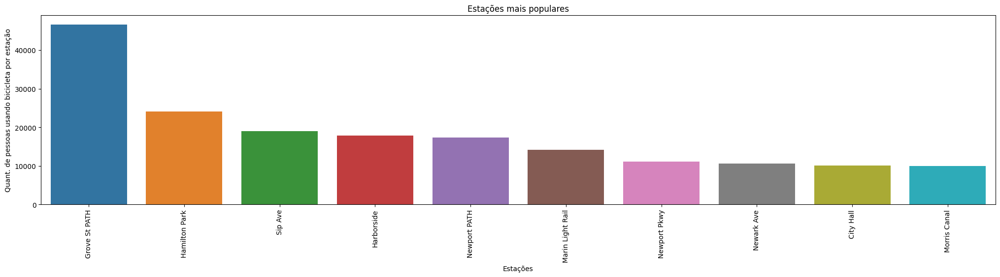

In [126]:
topStartStation = df["start station name"].value_counts().head(10)
plt.figure(figsize = (25,5))
ax = sns.barplot(x=topStartStation.index,
       y=topStartStation)
ax.set(xlabel='Estações', ylabel='Quant. de pessoas usando bicicleta por estação', title='Estações mais populares')
plt.xticks(rotation=90)
plt.show()

### Existe alguma relação das 10 estações mais pupolares com a idade?

In [127]:
df_age = pd.DataFrame(df[['start station name','ageGroup']].value_counts()).reset_index().rename(columns={'start station name': 'estacao', 'ageGroup': 'faixa etaria', 0:'quant'})
df_age.drop_duplicates(['estacao']).head(10)


,estacao,faixa etaria,quant
0,Grove St PATH,30-39,20168
3,Hamilton Park,30-39,9164
4,Sip Ave,30-39,7201
5,Marin Light Rail,30-39,6775
6,Harborside,30-39,6417
7,Newport PATH,30-39,6292
13,Brunswick & 6th,30-39,4938
14,Monmouth and 6th,30-39,4892
15,Warren St,30-39,4408
16,City Hall,30-39,4334


Incrivelmente a faixa estária de `30-39` anos está predominando.

### As 10 rotas mais populares

Vamos verificar quais são as rotas Origem-Destino mais realizadas.

In [128]:
trips = df.groupby(['start station name','end station name']).size().reset_index(name = 'Num. of Trips')
trips = trips.sort_values('Num. of Trips',ascending = False)
trips.head(10)

,start station name,end station name,Num. of Trips
991,Hamilton Park,Grove St PATH,8778
939,Grove St PATH,Hamilton Park,6048
224,Brunswick & 6th,Grove St PATH,5251
1764,Marin Light Rail,Grove St PATH,4450
1406,Jersey & 6th St,Grove St PATH,4370
955,Grove St PATH,Marin Light Rail,4167
276,Brunswick St,Grove St PATH,4078
1866,Monmouth and 6th,Grove St PATH,3993
632,Dixon Mills,Grove St PATH,3870
1845,McGinley Square,Sip Ave,3806


As rotas mais populares possuem uma relação de localização, sendo concentrada no centro da cidade de Jersey.

### Quantidades de vezes que uma estação foi escolida  como Destino e Origem por mês

#### Escolhida como Origem

In [129]:
# Número de vezes que cada estação serviu de origem para uma viagem em cada mês
startStation = df.groupby(['start station name', 'start_month']).size().reset_index().rename(columns={'start station name': 'estacao', 'start_month': 'mes', 0:'quant origem'})
startStation = startStation.sort_values('quant origem',ascending = False)
startStation.head(10)

,estacao,mes,quant origem
204,Grove St PATH,August,5458
214,Grove St PATH,September,5279
208,Grove St PATH,July,4833
213,Grove St PATH,October,4674
209,Grove St PATH,June,4492
211,Grove St PATH,May,4113
203,Grove St PATH,April,3725
212,Grove St PATH,November,3577
226,Hamilton Park,September,3123
210,Grove St PATH,March,3112


#### Escolhida como Destino

In [130]:
# Número de vezes que cada estação foi o destino de uma viagem de cada mês
endStation = df.groupby(['end station name', 'start_month']).size().reset_index().rename(columns={'end station name': 'estacao', 'start_month': 'mes', 0:'quant destino'})
endStation = endStation[endStation['estacao'].isin(df['start station name'].unique())].reset_index(drop = True)
endStation = endStation.sort_values('quant destino',ascending = False)
endStation.head(10)

,estacao,mes,quant destino
213,Grove St PATH,October,6766
204,Grove St PATH,August,6671
214,Grove St PATH,September,6541
208,Grove St PATH,July,6265
211,Grove St PATH,May,5283
209,Grove St PATH,June,5223
212,Grove St PATH,November,5048
203,Grove St PATH,April,4577
210,Grove St PATH,March,3486
205,Grove St PATH,December,3027


#### Resultado final das escolhas

In [131]:
# Resultado final
station_use = pd.merge(startStation, endStation, on=['estacao', 'mes'])
station_use['total'] = station_use['quant origem'] + station_use['quant destino']
station_use = station_use.sort_values('total',ascending = False)
station_use.head(10)

,estacao,mes,quant origem,quant destino,total
0,Grove St PATH,August,5458,6671,12129
1,Grove St PATH,September,5279,6541,11820
3,Grove St PATH,October,4674,6766,11440
2,Grove St PATH,July,4833,6265,11098
4,Grove St PATH,June,4492,5223,9715
5,Grove St PATH,May,4113,5283,9396
7,Grove St PATH,November,3577,5048,8625
6,Grove St PATH,April,3725,4577,8302
9,Grove St PATH,March,3112,3486,6598
8,Hamilton Park,September,3123,2840,5963


### Número total de vezes que cada estação foi usada por mês

In [132]:
pd.crosstab(index = station_use['estacao'], columns = station_use['mes'], values = station_use['total'], aggfunc = 'sum')

mes,April,August,December,February,January,July,June,March,May,November,October,September
estacao,,,,,,,,,,,,
5 Corners Library,505.0,538.0,162.0,200.0,176.0,524.0,455.0,330.0,429.0,292.0,509.0,588.0
Astor Place,654.0,782.0,521.0,452.0,485.0,696.0,810.0,528.0,702.0,603.0,689.0,723.0
Baldwin at Montgomery,694.0,891.0,341.0,394.0,416.0,873.0,835.0,429.0,740.0,535.0,730.0,807.0
Bergen Ave,541.0,605.0,416.0,328.0,271.0,636.0,627.0,336.0,577.0,557.0,719.0,649.0
Brunswick & 6th,1538.0,1902.0,1099.0,852.0,954.0,1973.0,1561.0,1154.0,1479.0,1586.0,1920.0,1999.0
Brunswick St,1307.0,1916.0,832.0,964.0,861.0,1729.0,1554.0,1123.0,1381.0,1138.0,1694.0,1759.0
Christ Hospital,373.0,382.0,201.0,168.0,240.0,420.0,463.0,266.0,407.0,306.0,428.0,449.0
City Hall,1808.0,2239.0,982.0,1022.0,1069.0,2210.0,2231.0,1440.0,1919.0,1413.0,1973.0,2493.0
Columbus Dr at Exchange Pl,NaN,4799.0,1653.0,NaN,NaN,2275.0,NaN,NaN,NaN,2802.0,4041.0,4841.0


### Classificação da duração da viagem

In [133]:
df['TripDurationMinGroup']=pd.cut(
   df['tripduration_in_min'],
   bins=[0, 6, 16, 31, 46, sys.maxsize],
   labels=['1-5', '15-29', '30-44', '45-59', '60+']
)

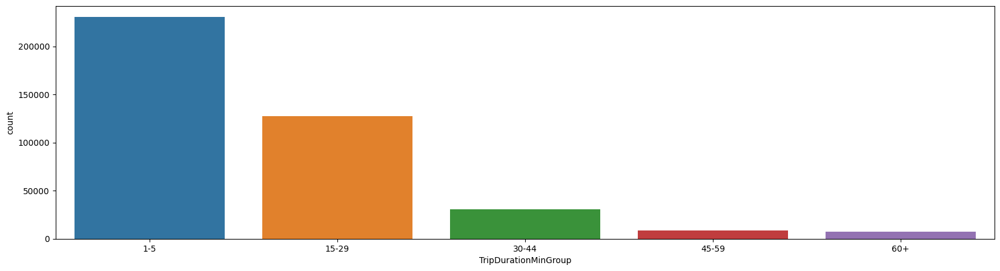

In [134]:
plt.figure(figsize = (20,5))
sns.countplot(x=df["TripDurationMinGroup"])
plt.show()

### Relação de viagem que começam e terminam na mesma estação

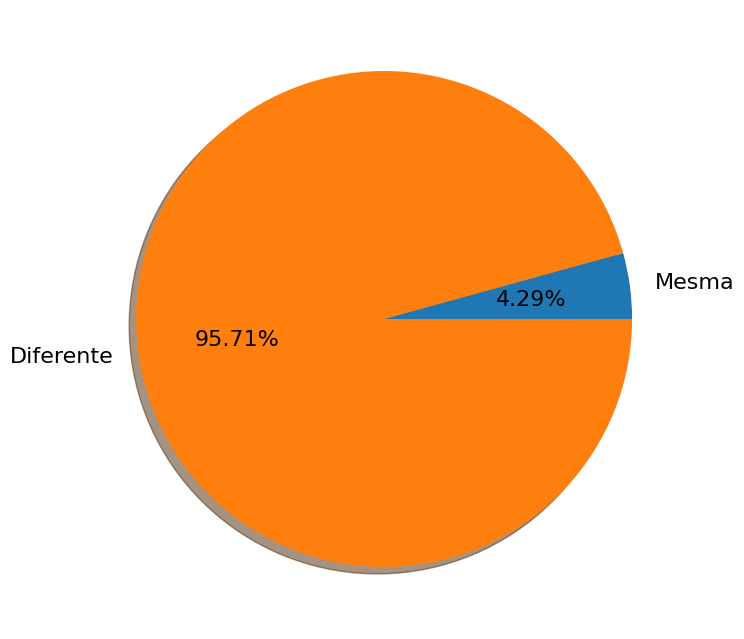

In [135]:
# Quantidade de viagem que começam e terminam na mesma estação
same = df[df['start station name'] == df['end station name']].shape[0]

#Quantidade de viagens que começaram e terminanram em estações diferentes
diff = df.shape[0]-same

plt.figure(figsize=(8,10))
plt.pie([same,diff], labels=['Mesma', 'Diferente'],
        shadow=True,  autopct='%1.2f%%', textprops={'fontsize': 16})
# ax1.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.show()

### Distribuição da idade e gênero por estação

#### Ditribuição gênero por estação

In [136]:
stationGender = df.groupby(['start station name', 'gender']).size().reset_index(name='count')
stationGender = stationGender[stationGender['start station name'].isin(topStartStation.index)].reset_index(drop = True)
stationGender['gender'] = stationGender['gender'].map({0:'desconhecido', 1: 'masculino', 2: 'feminino'})

In [137]:
fig = px.bar(stationGender, x='start station name', y='count',
             color='gender', log_y=True,
              height=400)
fig.show()

#### Ditribuição idade por estação

In [138]:
stationAge = df.groupby(['start station name', 'gender', 'ageGroup']).size().reset_index(name='count')
stationAge = stationAge[stationAge['start station name'].isin(topStartStation.index)].reset_index(drop = True)

In [139]:
fig = px.histogram(stationAge, x="start station name", y='count',
             color='ageGroup', barmode='group',
             height=400, title='Idade x Estação', log_y=True)
fig.update_xaxes(categoryorder='array', categoryarray= weekOrder)

fig.show()

Por se tratar de uma área residencial, a Sip Ave concentrar grande partes dos jovens menores de 20 anos. Para as demais idades, temos uma distribuição parecida.

## Analisando Corridas Paralelas

Iremos levar em consideração um difereça de `30 segundos` entre as saídas.

In [140]:
df_paralela = df[['starttime', 'stoptime', 'start station name', 'end station name']].copy()
df_paralela["starttime"] = df_paralela["starttime"].dt.round("min")
df_paralela["stoptime"] = df_paralela["stoptime"].dt.round("min")

In [141]:
df_paralela['User Row'] = df_paralela.index.astype(str)
df_paralela.head()

,starttime,stoptime,start station name,end station name,User Row
0,2019-01-01 03:09:00,2019-01-01 03:13:00,Exchange Place,Essex Light Rail,0
1,2019-01-01 05:18:00,2019-01-01 05:26:00,Exchange Place,Washington St,1
2,2019-01-01 10:37:00,2019-01-01 10:49:00,Exchange Place,Liberty Light Rail,2
3,2019-01-01 12:44:00,2019-01-01 13:10:00,Exchange Place,Washington St,3
4,2019-01-01 12:44:00,2019-01-01 13:10:00,Exchange Place,Washington St,4


In [142]:
df_2 = df_paralela.groupby(['starttime','stoptime','start station name','end station name'], as_index = False).agg({'User Row': ','.join}).reset_index(drop=True)
df_duplas = df_2[df_2['User Row'].str.contains(",")].reset_index(drop=True)
df_duplas

,starttime,stoptime,start station name,end station name,User Row
0,2019-01-01 01:03:00,2019-01-01 01:07:00,Manila & 1st,Hamilton Park,"14389,14390"
1,2019-01-01 09:45:00,2019-01-01 09:48:00,Jersey & 6th St,Newark Ave,"13410,13411"
2,2019-01-01 11:34:00,2019-01-01 11:37:00,Hamilton Park,Manila & 1st,"8143,8144,8145"
3,2019-01-01 12:44:00,2019-01-01 13:10:00,Exchange Place,Washington St,"3,4"
4,2019-01-01 13:48:00,2019-01-01 14:05:00,Grove St PATH,Grand St,"1699,1700"
...,...,...,...,...,...
10507,2019-12-31 18:46:00,2019-12-31 18:48:00,Columbus Dr at Exchange Pl,Harborside,"404864,404865"
10508,2019-12-31 19:07:00,2019-12-31 19:14:00,Liberty Light Rail,Grove St PATH,"404870,404872"
10509,2019-12-31 19:07:00,2019-12-31 19:15:00,City Hall,Brunswick St,"404871,404873"
10510,2019-12-31 19:18:00,2019-12-31 19:23:00,Harborside,Newport PATH,"404879,404880"


In [143]:
# Testando se os ciclistas sairam juntos
df.loc[3:4][['starttime', 'stoptime', 'start station name', 'end station name']]

,starttime,stoptime,start station name,end station name
3,2019-01-01 12:43:38.643,2019-01-01 13:09:54.528,Exchange Place,Washington St
4,2019-01-01 12:43:39.601,2019-01-01 13:09:46.510,Exchange Place,Washington St


In [144]:
# Verificando o maior grupo de pessoas pedalando juntas
df_duplas['User Row'].str.split(',').agg(len).to_frame(name='Count').max()


Count    6
dtype: int64

### As 10 estações de origem mais escolhidas para sair em grupo

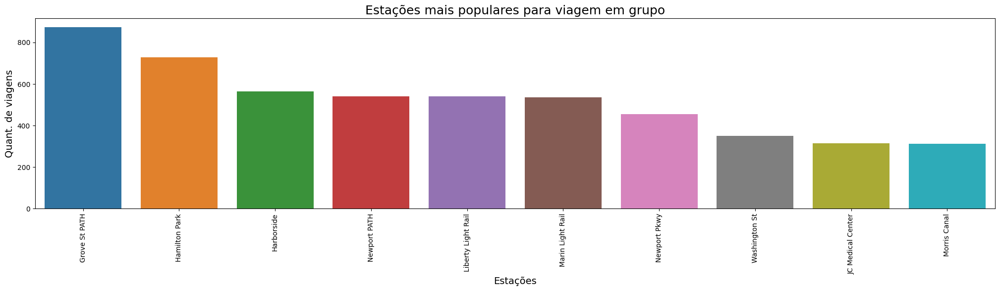

In [145]:
popularStation = df_duplas.groupby(['start station name']).size().sort_values(ascending=False).head(10)
plt.figure(figsize = (25,5))
ax = sns.barplot(x=popularStation.index, y=popularStation)
plt.xticks(rotation=90)
plt.title('Estações mais populares para viagem em grupo', fontsize=18)
plt.xlabel('Estações', fontsize=14)
plt.ylabel('Quant. de viagens', fontsize=14)
plt.show()

### As 10 rotas mais escolhidas para sair em grupo

In [146]:
trips = df_duplas.groupby(['start station name','end station name']).size().reset_index(name = 'Num. of Trips')
trips = trips.sort_values('Num. of Trips',ascending = False)
trips.head(10)

,start station name,end station name,Num. of Trips
499,Hamilton Park,Grove St PATH,273
826,Liberty Light Rail,Liberty Light Rail,208
94,Brunswick & 6th,Grove St PATH,168
124,Brunswick St,Grove St PATH,121
972,Monmouth and 6th,Grove St PATH,116
912,Marin Light Rail,Grove St PATH,115
460,Grove St PATH,Hamilton Park,112
473,Grove St PATH,Marin Light Rail,103
720,Jersey & 6th St,Grove St PATH,99
1103,Newport PATH,Harborside,99


## Conclusão

- Podemos ver um maior número de ciclistas do sexo masculino. 
- Podemos ver que há mais assinantes anuais do que clientes comuns. 
- Os horários mais procurados são as 8h e 18h, consequentimente horarios de inicio e termino de espediente.
- Há um grande numero de pessoa na faixa etária de 30 a 39 anos.
- Há um baixo numero de clientes mês de Maio.
- Quase 96% dos passeios têm diferentes locais de início e término.
- O maior numero de pessoas andando juntas foram de 6.
- As estações do centro da cidade são as mais procuradas.
- Os não assinantes usam mais durante o final de semana.
- Grande parte do jovens menos de 20 anos, usam no bairro vizinho ao centro da cidade.

# Predição

In [147]:
from statsmodels.tsa.seasonal import seasonal_decompose

In [148]:
def applyer(row):
    if row.dayofweek == 5 or row.dayofweek == 6:
        return 1
    else:
        return 0

In [149]:
df_serie = pd.DataFrame()
df_serie['starttime'] = df['starttime'].dt.round('h')
df_serie

,starttime
0,2019-01-01 03:00:00
1,2019-01-01 05:00:00
2,2019-01-01 11:00:00
3,2019-01-01 13:00:00
4,2019-01-01 13:00:00
...,...
404942,2019-12-31 23:00:00
404943,2019-12-31 23:00:00
404944,2019-12-31 23:00:00
404945,2019-12-31 23:00:00


In [150]:
df_serie = df_serie.groupby(['starttime']).size().reset_index(name='count_trip')
data2 = df_serie

In [151]:
df_serie['hour'] = df_serie['starttime'].dt.hour
df_serie['day'] = df_serie['starttime'].dt.day
df_serie['day_of_week'] = df_serie['starttime'].dt.weekday
df_serie['weekend'] = df_serie['starttime'].apply(applyer)

In [152]:
df_serie

,starttime,count_trip,hour,day,day_of_week,weekend
0,2019-01-01 00:00:00,2,0,1,1,0
1,2019-01-01 01:00:00,3,1,1,1,0
2,2019-01-01 02:00:00,5,2,1,1,0
3,2019-01-01 03:00:00,6,3,1,1,0
4,2019-01-01 04:00:00,5,4,1,1,0
...,...,...,...,...,...,...
8430,2019-12-31 20:00:00,25,20,31,1,0
8431,2019-12-31 21:00:00,14,21,31,1,0
8432,2019-12-31 22:00:00,10,22,31,1,0
8433,2019-12-31 23:00:00,10,23,31,1,0


In [153]:
data = df_serie
data.set_index('starttime', inplace=True)
# data.index = pd.DatetimeIndex(data.index).to_period('h')

In [154]:
fig = px.line(data,y='count_trip')
fig.show()

In [155]:
decomposicao = seasonal_decompose(data.count_trip, period=24, model='additive')

In [156]:
tendencia = decomposicao.trend
sazonal = decomposicao.seasonal
aleatorio = decomposicao.resid

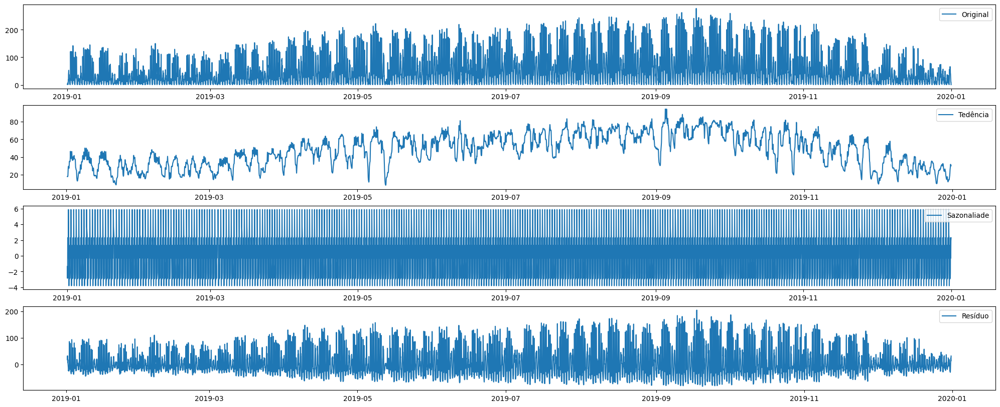

In [157]:
fig, ax = plt.subplots(4, 1, figsize=(25,10))
# create subplots
ax[0].plot(data.count_trip, label= 'Original')
ax[0].legend()

ax[1].plot(tendencia, label= 'Tedência')
ax[1].legend()

ax[2].plot(sazonal, label= 'Sazonaliade')
ax[2].legend()

ax[3].plot(aleatorio, label= 'Resíduo')
ax[3].legend()



In [158]:
hourly = data.resample('H').mean() 
daily = data.resample('D').mean() 
weekly = data.resample('W').mean() 
monthly = data.resample('M').mean()

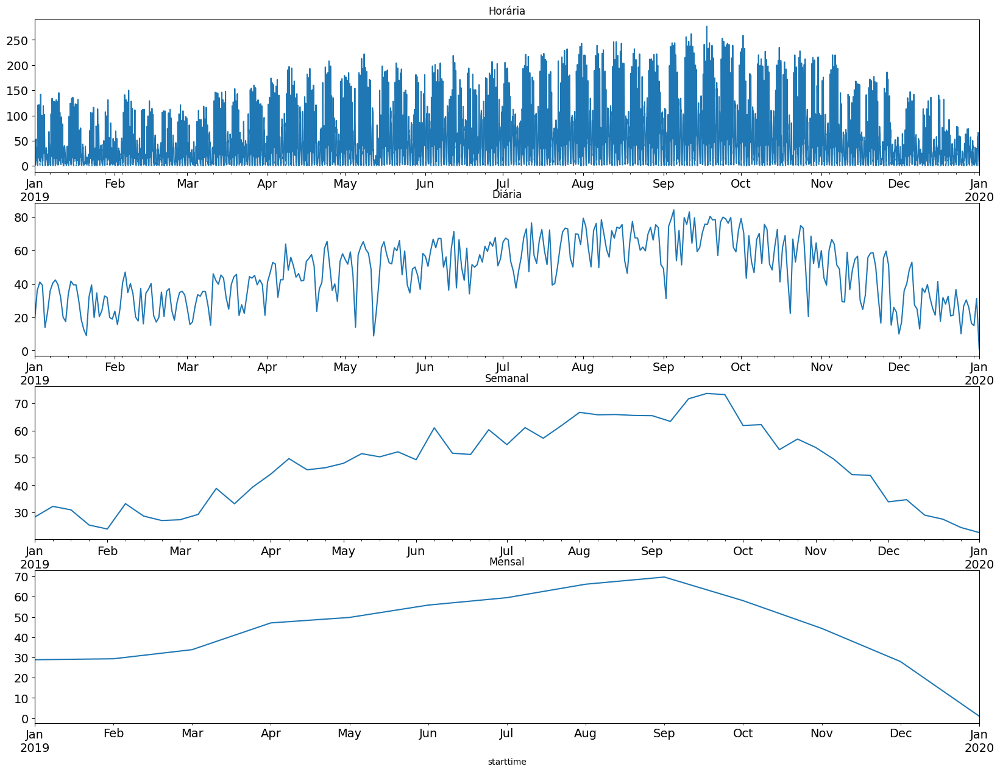

In [159]:
fig, axs = plt.subplots(4,1) 
hourly.count_trip.plot(figsize=(20,15), title= 'Horária', fontsize=14, ax=axs[0])
daily.count_trip.plot(figsize=(20,15), title= 'Diária', fontsize=14, ax=axs[1])
weekly.count_trip.plot(figsize=(20,15), title= 'Semanal', fontsize=14, ax=axs[2]) 
monthly.count_trip.plot(figsize=(20,15), title= 'Mensal', fontsize=14, ax=axs[3]) 
plt.show()

In [160]:
treino = data.loc['2019-01-01':'2019-09-01']
teste = data.loc['2019-09-01':]

In [183]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=data.index, y=treino['count_trip'], name='Treinamento'))
fig.add_trace(go.Scatter(x=teste.index, y=teste['count_trip'], name='Teste'))
fig.update_layout(margin={"r":10,"t":10,"l":10,"b":10})
fig.show()

In [253]:
# dados de treinamento
day = [x.day for x in treino.index]
hour = [x.hour for x in treino.index]
weekend = [applyer(x) for x in treino.index]
data_trein = np.array([hour, weekend]).T

# dados de teste
day = [x.day for x in teste.index]
hour = [x.hour for x in teste.index]
weekend = [applyer(x) for x in teste.index]
data_teste = np.array([ hour, weekend]).T

In [254]:
# treinando
my_rf = RandomForestRegressor()
my_rf.fit(data_trein, treino.count_trip.values)
 
# previsao
preds = my_rf.predict(data_teste)

In [255]:
rms = sqrt(mean_squared_error(teste.count_trip, preds))
rms

29.967014956146397

In [256]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=data.index, y=data.count_trip.values, name='Original'))
fig.add_trace(go.Scatter(x=teste.index, y=preds, name='Previsão'))
fig.update_layout(margin={"r":10,"t":10,"l":10,"b":10})
fig.show()

In [248]:
# Import the library
from pmdarima import auto_arima
  
# Ignore harmless warnings
import warnings
warnings.filterwarnings("ignore")
  
stepwise_fit = auto_arima(data['count_trip'], start_p = 1, start_q = 1,
                          max_p = 3, max_q = 3, m = 1,
                          start_P = 0, seasonal = True,
                          d = None, D = 1, trace = True,
                          error_action ='ignore',   # we don't want to know if an order does not work
                          suppress_warnings = True,  # we don't want convergence warnings
                          stepwise = True)           # set to stepwise
  
# To print the summary
stepwise_fit.summary()

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=81655.888, Time=5.13 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=82824.195, Time=0.25 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=82198.304, Time=0.65 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=81716.315, Time=1.62 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=82822.195, Time=0.14 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=7.83 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=5.84 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=81569.496, Time=2.22 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=inf, Time=6.39 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=inf, Time=10.77 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=81567.496, Time=0.87 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=81714.315, Time=0.62 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=inf, Time=3.22 sec
 ARIMA(0,1,3)(0,0,0)[0]             : AIC=inf, Time=2.99 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=81653.888, T

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                 8435
Model:               SARIMAX(0, 1, 2)   Log Likelihood              -40780.748
Date:                Tue, 11 Oct 2022   AIC                          81567.496
Time:                        14:41:28   BIC                          81588.616
Sample:                             0   HQIC                         81574.706
                               - 8435                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1          0.3073      0.006     48.400      0.000       0.295       0.320
ma.L2         -0.1755      0.008    -23.188      0.000      -0.190      -0.161
sigma2       927.6425      8.394    110.508      0.000     911.190     944.095
===================================================================================
Ljung-Box (L1) (Q):                  10.60   Jarque-Bera (JB):              5669.14
Prob(Q):                              0.00   Prob(JB):                         0.00
Heteroskedasticity (H):               1.64   Skew:                             0.50
Prob(H) (two-sided):                  0.00   Kurtosis:                         6.89
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [249]:
 # Fit a SARIMAX(0, 1, 1)x(2, 1, 1, 12) on the training set
from statsmodels.tsa.statespace.sarimax import SARIMAX
  
model = SARIMAX(treino['count_trip'], 
                order = (0, 1, 1), 
                seasonal_order =(2, 1, 1, 12))
  
result = model.fit()
result.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                      
==========================================================================================
Dep. Variable:                         count_trip   No. Observations:                 5630
Model:             SARIMAX(0, 1, 1)x(2, 1, 1, 12)   Log Likelihood              -26851.637
Date:                            Tue, 11 Oct 2022   AIC                          53713.274
Time:                                    14:42:54   BIC                          53746.442
Sample:                                         0   HQIC                         53724.830
                                           - 5630                                         
Covariance Type:                              opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1          0.3353      0.007     44.780      0.000       0.321       0.350
ar.S.L12       0.0039      0.010      0.392      0.695      -0.015       0.023
ar.S.L24       0.2995      0.008     37.531      0.000       0.284       0.315
ma.S.L12      -0.9999      0.165     -6.065      0.000      -1.323      -0.677
sigma2       821.4131    134.293      6.117      0.000     558.204    1084.623
===================================================================================
Ljung-Box (L1) (Q):                  16.91   Jarque-Bera (JB):              3289.08
Prob(Q):                              0.00   Prob(JB):                         0.00
Heteroskedasticity (H):               2.03   Skew:                            -0.22
Prob(H) (two-sided):                  0.00   Kurtosis:                         6.72
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

<AxesSubplot: xlabel='starttime'>

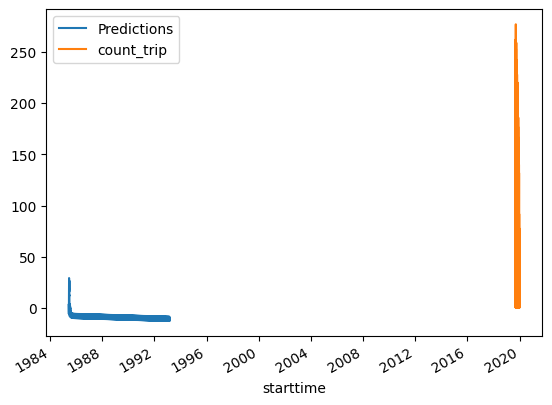

In [250]:
start = len(treino)
end = len(treino) + len(teste) - 1
  
# Predictions for one-year against the test set
predictions = result.predict(start, end,
                             typ = 'levels').rename("Predictions")
  
# plot predictions and actual values
predictions.plot(legend = True)
teste['count_trip'].plot(legend = True)